In [88]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import LogNorm, PowerNorm

%matplotlib inline

from scipy import interpolate
from mpl_toolkits.basemap import Basemap
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.misc import imread

In [6]:
def make_historical_diagram():
    '''
    do all of the stuff for the graphics of making a hurricane plot
    
    takes in the year dataframe in order to get the necessary data
    
    returns ax which is the figure axis that the current hurricane track will be added upon
    '''
    # establish the figure
    figure = plt.figure(figsize=(19.2, 12.0), dpi=100)
    
    axis = figure.add_subplot(111)
    axis.set_facecolor("#000000")
    
#     figure, axis = plt.subplots(figsize=(19.2,12.00), dpi=100)
    
#     data = np.linspace(165.0, 0, 10000).reshape(100,100)
# #     data = np.clip(randn(250, 250), -1, 1)

#     histo_image = axis.imshow(data, interpolation='nearest', cmap="inferno")
    
#     divider = make_axes_locatable(axis)
    
#     cax = divider.append_axes("right", size="2%", pad=0.05)

#     # Add colorbar, make sure to specify tick locations to match desired ticklabels
#     cbar = figure.colorbar(histo_image, ticks=[157, 130, 111, 96, 74, 39, 0], cax=cax)
#     cbar.ax.set_yticklabels(['5^', '4^', '3^', '2^', '1^', 'T.S.^', 'T.D.^'])  # vertically oriented colorbar
#     axis.set_title("North American Hurricane Tracks " + str(_year), size=20)
#     axis.set_xlabel("Longitude", size=16)
#     axis.set_ylabel("Latitude", size=16)
#     axis.set_facecolor("black")
    axis.set_xlim(-120.0, -30.0)
    axis.set_ylim(0, 50.0)
    
    return figure, axis
    
def heatmap(ax, storm):
    '''
    make a heatmap of storm track?
    '''
    x, y = storm_heat(storm)
    
    ax.hexbin(x, y, gridsize=50, bins="log", cmap="inferno")
    
    # ax.hexbin(x, y, gridsize=50, bins='log', cmap='inferno')
    
def storm_heat(storm):
    '''
    make storm track into two lists that will be turned into a heatmap
    '''
    _x = []
    _y = []
    
    if len(storm) >= 5:
        interpolation_multiplier = 120

        _lat = storm.Latitude.apply(lambda x: float(x))
        _long = storm.Longitude.apply(lambda x: float(x))

#         _strengths = storm.loc[:,"Wind(WMO)"].apply(lambda x: int(((x / 165.0) * 5.0)**2))
        
        # since the 'saffir_simpson_cat' column ranges from -1 to 5 add 2 to it
        # so that the range is 1 <-> 7 which a computer understands better
        _strengths = storm.loc[:, "saffir_simpson_cat"].apply(lambda x: int((x + 2)**2))
        
        new_length = interpolation_multiplier * len(_lat)

        x = np.arange(len(_lat))

        # figure out length of new arrays
        new_x = np.linspace(x.min(), x.max(), new_length)

        # actually do the interpolation
        new_lat = interpolate.interp1d(x, _lat, kind='cubic')(new_x)
        new_long = interpolate.interp1d(x, _long, kind='cubic')(new_x)
        new_strs = interpolate.interp1d(x, _strengths, kind='cubic')(new_x)
        
        for idx in range(len(new_lat)):
            _strength = int(new_strs[idx])
            for idy in range(_strength):
                _x.append(new_long[idx])
                _y.append(new_lat[idx])

    return _x, _y

def safsimpsonize(wind):
    '''
    Takes in wind speed
    
    Returns saffir-simpson hurricane category with 0 and -1 for tropical storm/depression
    which doesn't make perfect sense as scales go but this maintains categories but allows
    the model/visualization to detect when something is a tropical depression
    
    According to: https://en.wikipedia.org/wiki/Saffir%E2%80%93Simpson_scale
    
    Return:  Category:   Wind Speed Range: (mph, seriously?)
    5        Cat 5      157 <= v
    4        Cat 4      130 <= v < 157
    3        Cat 3      111 <= v < 130
    2        Cat 2      96 <= v < 111
    1        Cat 1      74 <= v < 96
    0        Storm      39 <= v < 74
    -1       Depression v < 39
    '''
    if wind >= 157:
        return 5
    elif wind >= 130:
        return 4
    elif wind >= 111:
        return 3
    elif wind >= 96:
        return 2
    elif wind >= 74:
        return 1
    elif wind >= 39:
        return 0
    else:
        return -1

def load_hurricane_data(_path="../data/allstorms.csv"):
    data = pd.read_csv(_path)

    # data dictionary
    # N/A,Year,#,BB,BB,N/A,YYYY-MM-DD HH:MM:SS,N/A,deg_north,deg_east,kt,mb,N/A,%,%,N/A

    data.loc[:,"Season"] = data.loc[:,"Season"].apply(lambda x: int(x))

#     print data.loc[:,"Basin"].unique()
    # array(['BB', ' SI', ' NA', ' EP', ' SP', ' WP', ' NI', ' SA'], dtype=object)

    data.loc[:, "Basin"] = data.loc[:, "Basin"].apply(lambda x: x.replace(" ", ""))

#     print data.loc[:,"Basin"].unique()
    # ['BB' 'SI' 'NA' 'EP' 'SP' 'WP' 'NI' 'SA']

    data_na = data[data.loc[:, "Basin"] == "NA"]
    
    data_na.loc[:,"saffir_simpson_cat"] = data_na["Wind(WMO)"].apply(lambda x: safsimpsonize(x))

    # try to give back memory
    del data
    
    return data_na

def get_data_as_yearlist(start_year, end_year):
    '''
    take in data frame (north atlantic most likely) and turn it into a list of dataframes
    with each entry being a dataframe holding a year's data
    '''
    # load data frame that we want
    data_na = load_hurricane_data()
    
    # make a list for the years
    years = []

    # step through the Seasons (years) and make a new dataframe for each one
    for year in data_na.loc[:, "Season"].unique():
        temp = data_na[data_na.loc[:, "Season"] == year]
        years.append(temp)

    # get rid of a nan DataFrame
    years.pop(0)

    #loop through years in future gif
    start = 164 - (2016 - start_year)
    end = 164 - (2016 - end_year)
    
    if start != end:
        temp = years[start:end]
    else:
        # handle case where only one year is wanted
        temp = []
        temp.append(years[start])
    
    # try to give back memory
    del years
    
    return temp

def get_storms_from_year(year_df):
    '''
    year_df is the dataframe with a year's data
    
    returns a list of smaller dataframes each consisting of a 
    unique storm track
    '''
    storms = []
    
    # step through the year and make a dataframe for each storm
    for storm in year_df.loc[:,"Serial_Num"].unique():
        storms.append(year_df[year_df.loc[:, "Serial_Num"] == storm])
        
    return storms

In [186]:
def get_map_data(_start=1915, _end=2016):
    # establish the range of years
    # ^ moved to function parameter

    # make a list of year dataframes for the range
    years = get_data_as_yearlist(_start, _end)

    big_x = []
    big_y = []

    # make a temp list to hold the storm dataframes from a single year
    for _idx, year in enumerate(years):

        storms = get_storms_from_year(year)

        for z, storm in enumerate(storms):

            x, y = storm_heat(storm)

            big_x += x
            big_y += y

    x = np.array(big_x)
    y = np.array(big_y)

    print len(x)


    print len(x), len(y)

    # x: 90
    # y: 40

    print "shape", _x.shape

    temp_x = []
    temp_y = []

    for idx in range(x.shape[0]):
        if 10 <= y[idx] <= 50 and -120 <= x[idx] <= -30:
            temp_x.append(x[idx])
            temp_y.append(y[idx])

    x = np.array(temp_x)
    y = np.array(temp_y)
    print
    print
    print "X min: {:2.1f} X max: {:2.1f}".format(x.min(), x.max())
    print "Y min: {:2.1f} Y max: {:2.1f}".format(y.min(), y.max())
    
    return x, y

def draw_map(grid_scale, x, y, _xs, _ys, gam1=1.0, gam2=2.0, file_name=None, color_map=0):

    color_dict = {0:"inferno", 1:"plasma", 2:"magma", 3:"viridis", 4:"hot", 5:"afmhot",
                 6:"gist_heat", 7:"copper", 8:"bone", 9:"gnuplot", 10:"gnuplot2",
                  11:"CMRmap", 12:"pink", 13:"spring", 14:"autumn_r", 15:"cool",
                 16:"Wistia", 17:"seismic", 18:"RdGy_r", 19:"BrBG_r", 20:"RdYlGn_r",
                 21:"PuOr", 22:"brg", 23:"hsv", 24:"cubehelix", 25:"gist_earth",
                 26:"ocean", 27:"gist_stern", 28:"gist_rainbow_r", 29:"jet", 
                 30:"nipy_spectral", 31:"gist_ncar"}
    
    _cmap = color_dict[color_map]
    
    
    grid = np.zeros((int(40 * grid_scale), int(90 * grid_scale)))
    grid2 = np.zeros((int(40 * grid_scale), int(90 * grid_scale)))
    
#     print grid.shape

    for idx in range(x.shape[0]):
        _Y = int(50 * grid_scale) - 2 - int(y[idx] * grid_scale)
        # was a -1 adjustment because counting starts at 0, changing to -2 because
        # storms tend to start on the right side and not hit the left side
        # so this is a hack-ey fix for what seems like a rounding problem
        _X = int(120 * grid_scale) - 2 + int(x[idx] * grid_scale)

        grid[_Y, _X] += 1
        
    for idy in range(_xs.shape[0]):
        _Ys = int(50 * grid_scale) - 2 - int(_ys[idy] * grid_scale)
        # was a -1 adjustment because counting starts at 0, changing to -2 because
        # storms tend to start on the right side and not hit the left side
        # so this is a hack-ey fix for what seems like a rounding problem
        _Xs = int(120 * grid_scale) - 2 + int(_xs[idy] * grid_scale)
        
        grid2[_Ys, _Xs] += 1

    # establish the figure
    fig = plt.figure(figsize=(19.2, 24.0), dpi=100)

    ax = fig.add_subplot(111)
    ax.set_facecolor("#000000")
    ax.clear()  # maybe clear erases some of the axis settings, not just the canvas?
    fig.subplots_adjust(0, 0, 1, 1)

    ax.set_xlim(-120.0, -30.0)
    ax.set_ylim(10, 50.0)

#     map_image = imread("../data/grey_blue_na_2.png")

#     ax.imshow(map_image, extent=[-120, -30, 10, 50], aspect="auto")

    ax.imshow(grid, norm=PowerNorm(gamma=gam1/gam2), cmap=_cmap, extent=[-120, -30, 10, 30], alpha=1.0, aspect="auto")
    ax.imshow(grid2, norm=PowerNorm(gamma=gam1/gam2), cmap=_cmap, extent=[-120, -30, 30, 50], alpha=1.0, aspect="auto")
    
    # write out file info so we can see how a map was made later w/ grid search
    desc = "grid_scale: {:2.2f}\n gam1: {:2.2f}\n gam2: {:2.2f}\n _cmap: {}".format(grid_scale, gam1, gam2, _cmap)
    ax.annotate(desc, xy=(-119, 43.8), size=30, color='#D0D0D0')
    
    if file_name != None:
        fig.savefig("../imgs/test/grid_heat/{}".format(file_name), pad_inches=0, transparent=True)
        plt.close("all")

    del _X, _Y, _Xs, _Ys
    
def run_map_grid_search(x, y, xs, xy, _start=0, _end=1000):
    '''
    Pick hyper parameters to use in a randomized grid search to try to 
    find a good looking heatmap setup
    '''
    
    for rdx in range(_start, _end):
        print "Making map [{:0>4}]/1000\r".format(rdx),
        _filename = "cmap_gsearch_num{:0>4d}.png".format(rdx)
        
        # pick grid_scale from lognormal distribution
        # with these values min/max of 10,000 test sample is ~0.5, 21.4
        mu, sigma = 1.2, 0.5
        # returns a numpy array so steal the first value in that to actually get the value
        _grid_scale = np.random.lognormal(mu, sigma, 1)[0]

        # gamma 1: pull from a normal distribution centered around 1.0
        norm_mu, norm_sigma = 1.5, 0.5

        _gam1 = np.random.normal(norm_mu, norm_sigma, 1)[0]

        # we don't want the value to go negative so if it is negative set it to 1.0
        if _gam1 <= 0:
            _gam1 = 1.0

        #, gamma 2, cmap? if so what cmap?
        g2_mu, g2_sigma = 3.0, 1.0

        do_over = 0

        _gam2 = -10

        # we want to keep picking until _gam2 is bigger than _gam1
        # but prevent infinite loops because that's really annoying
        while _gam2 < _gam1 or do_over < 1000:
            # break infinite loop
            do_over += 1
            _gam2 = np.random.normal(g2_mu, g2_sigma, 1)[0]

        # about 2/3rds the time use the non-standard color map
        _color_map = np.random.randint(0, 32)

    #     draw_map(grid_scale, x, y, _xs, _ys, gam1=1.0, gam2=2.0, file_name=None, color_map=0)
        draw_map(_grid_scale, x, y, xs, xy, _gam1, _gam2, color_map=_color_map, file_name=_filename)

In [101]:
### Establish x and y
x, y, = get_map_data()

17883240
17883240 17883240
shape (22869,)


X min: -109.5 X max: -30.0
Y min: 10.0 Y max: 50.0


In [154]:
### Establish small annual sample to get an idea for less busy map appearance also
small_x, small_y = get_map_data(2003, 2006)

1331348
1331348 1331348
shape (22869,)


X min: -107.7 X max: -30.0
Y min: 10.0 Y max: 50.0


(160, 360)


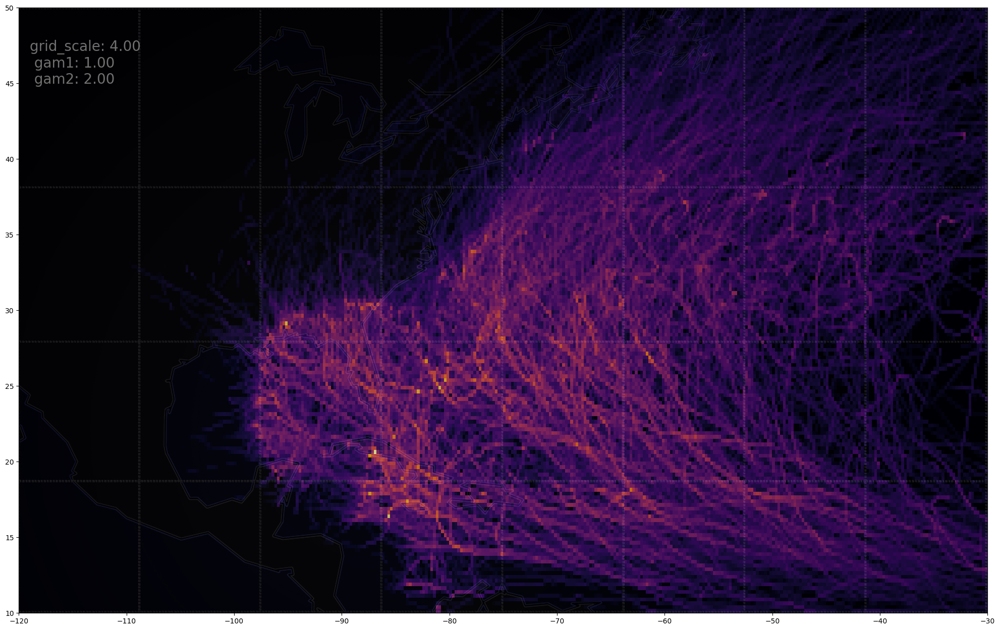

In [118]:
# draw_map(4.0, x, y, 1.0, 2.0, "boink.png")
draw_map(4.0, x, y, 1.0, 2.0)

(120, 270)


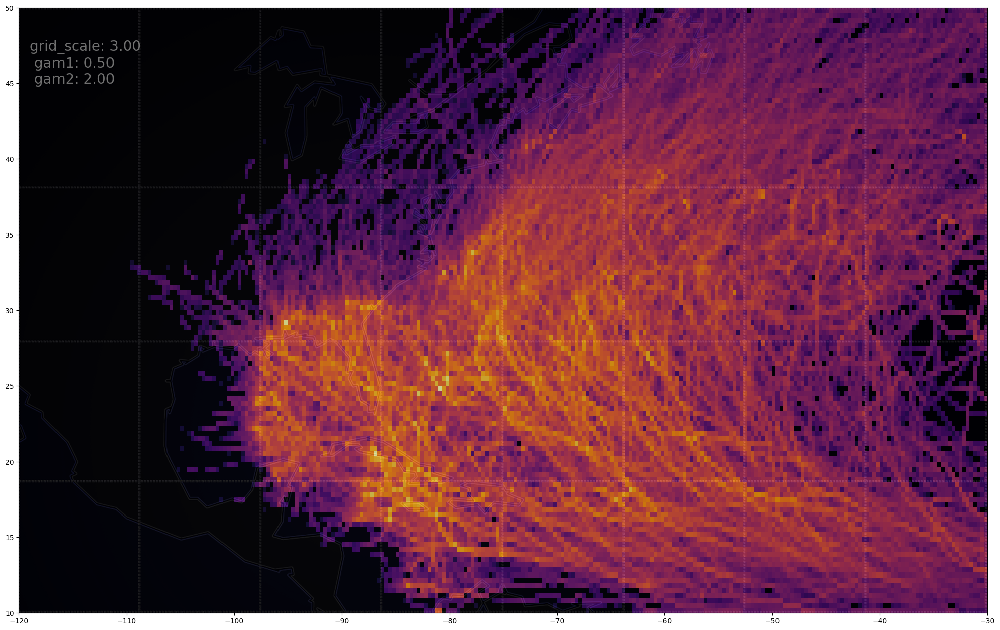

In [119]:
draw_map(3.0, x, y, 0.5, 2.0)

(120, 270)


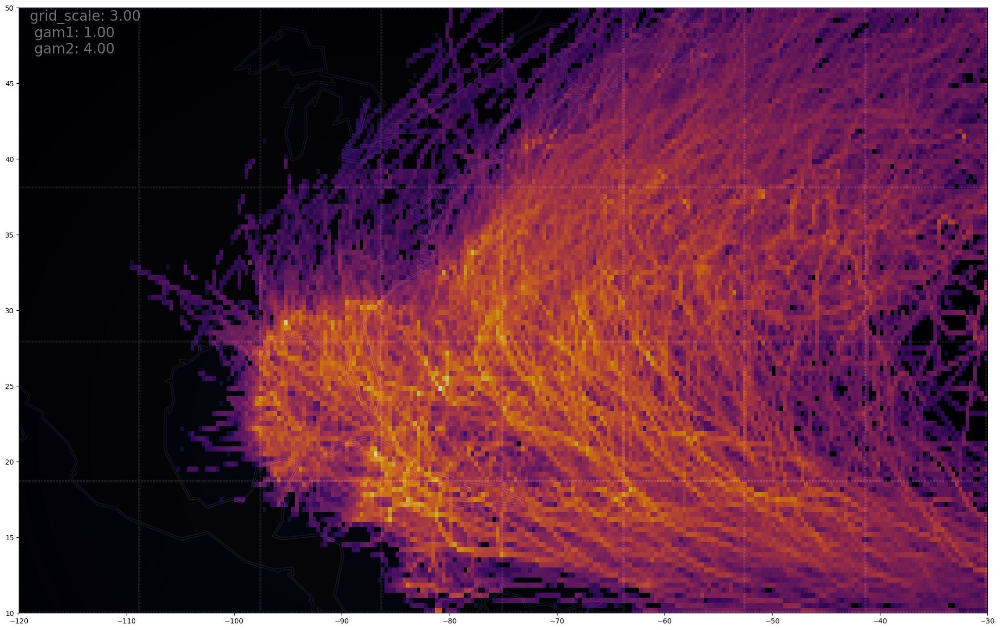

In [121]:
draw_map(3.0, x, y, 1.0, 4.0)

(120, 270)


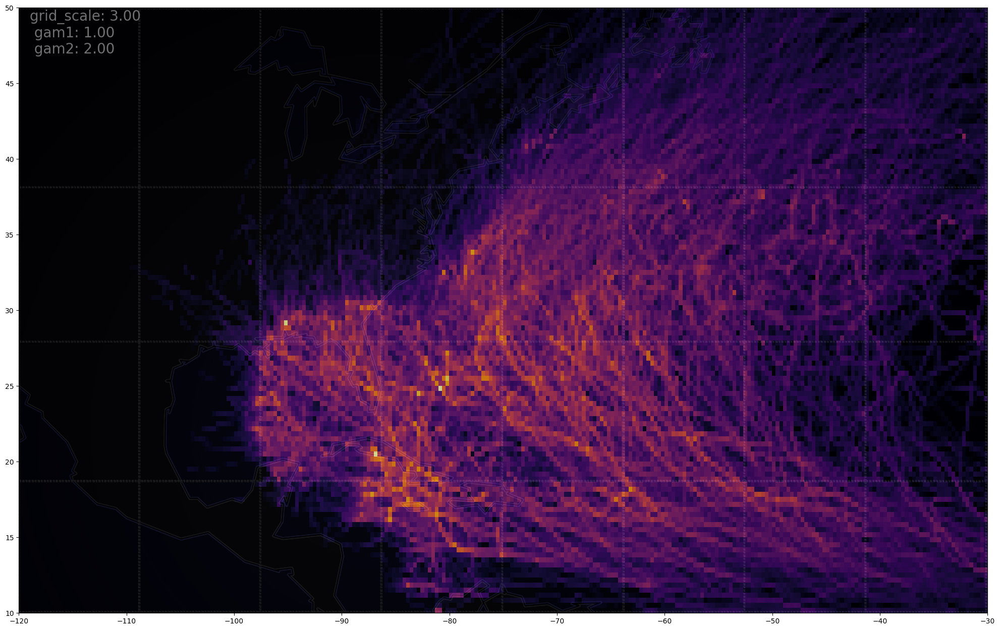

In [122]:
draw_map(3.0, x, y, 1.0, 2.0)

(40, 90)


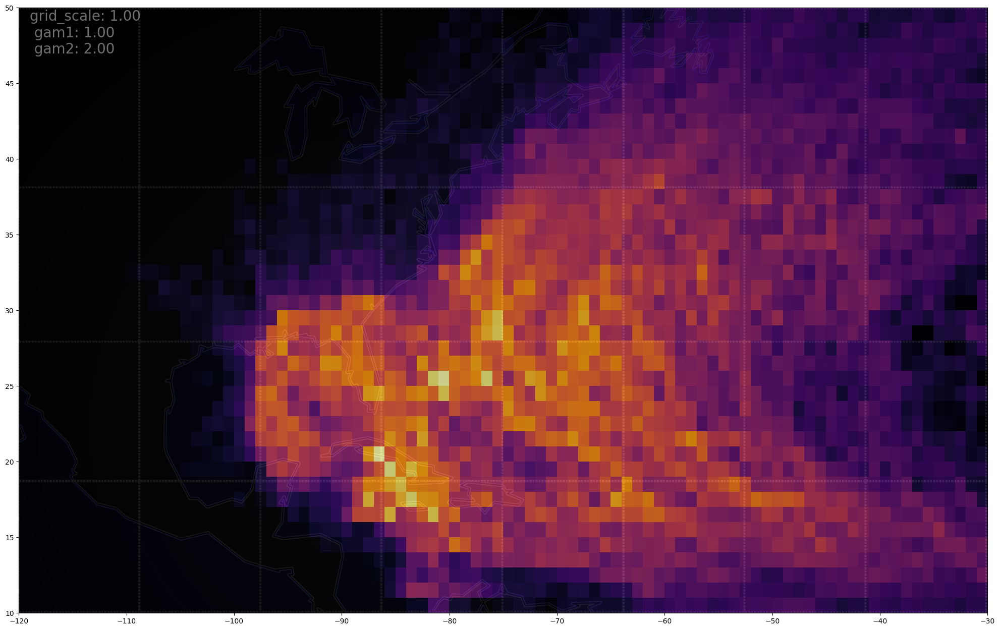

In [123]:
draw_map(1.0, x, y, 1.0, 2.0)

(40, 90)


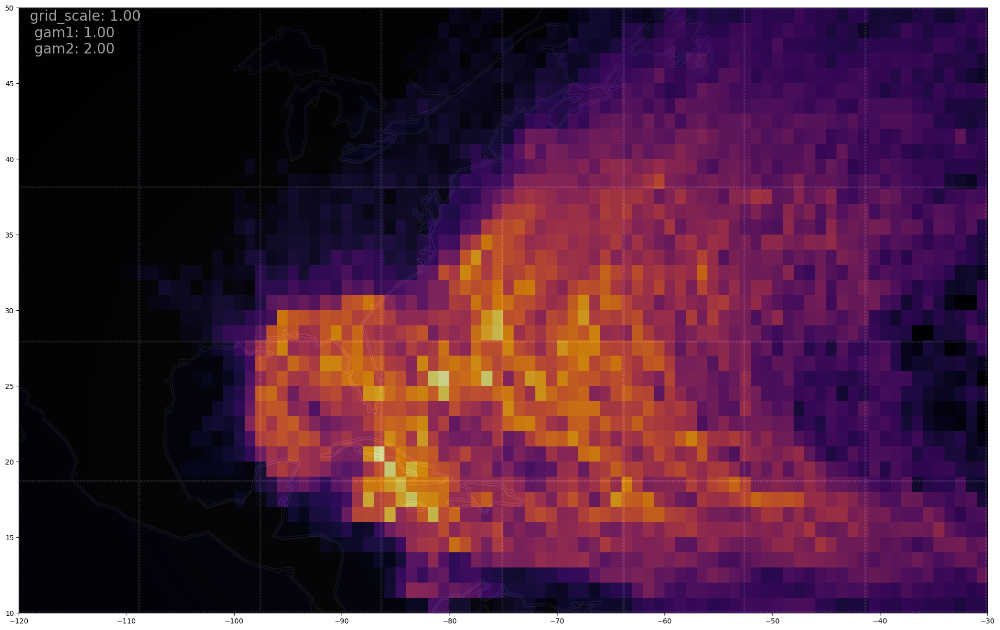

In [125]:
draw_map(1.0, x, y, 1.0, 2.0)

(128, 288)


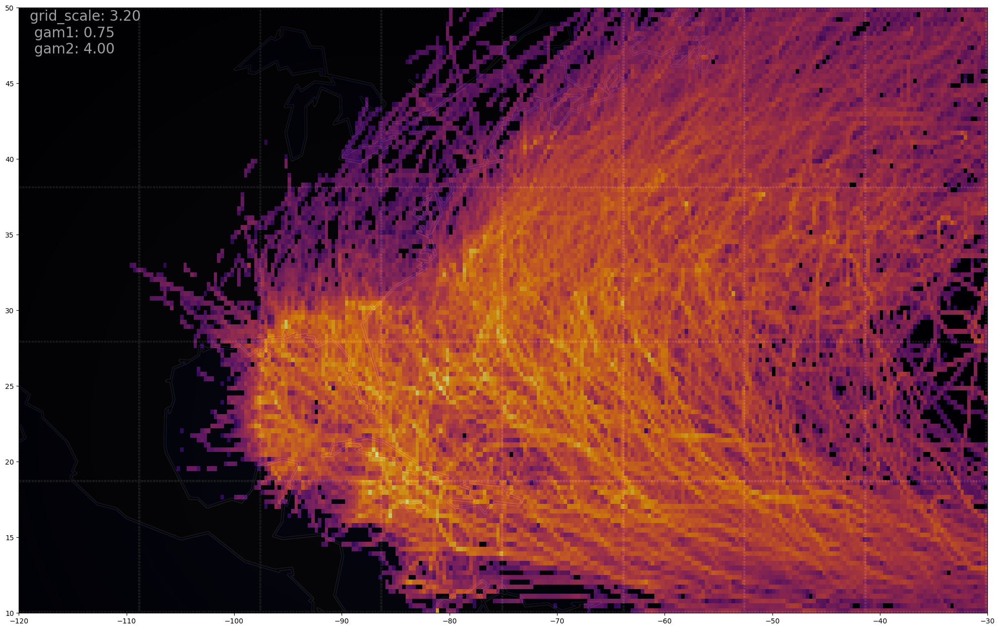

In [127]:
draw_map(3.2, x, y, 0.75, 4.0)

(200, 450)


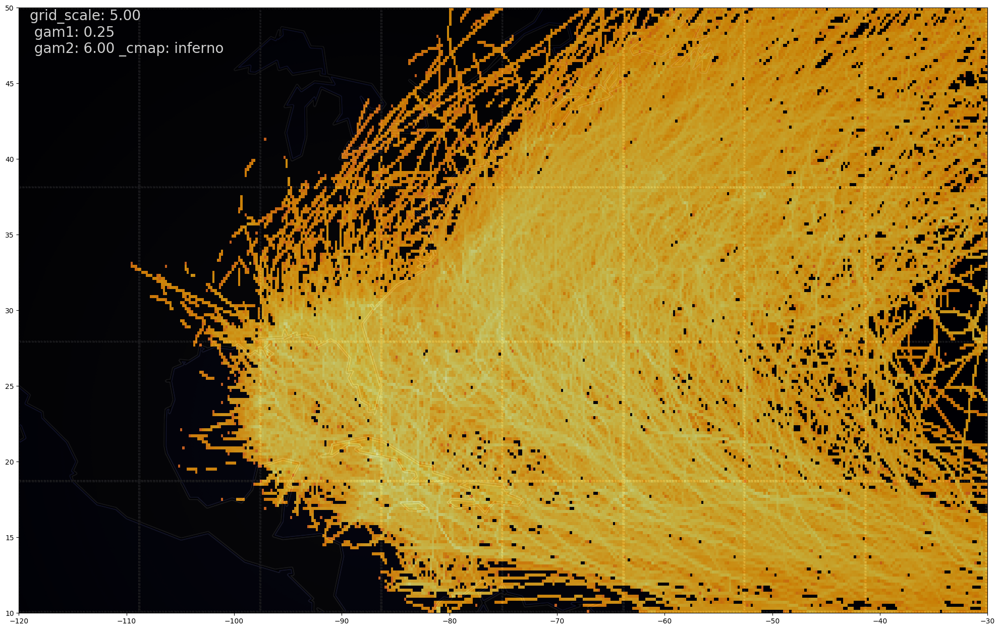

In [129]:
draw_map(5, x, y, 0.25, 6.0)

(200, 450)


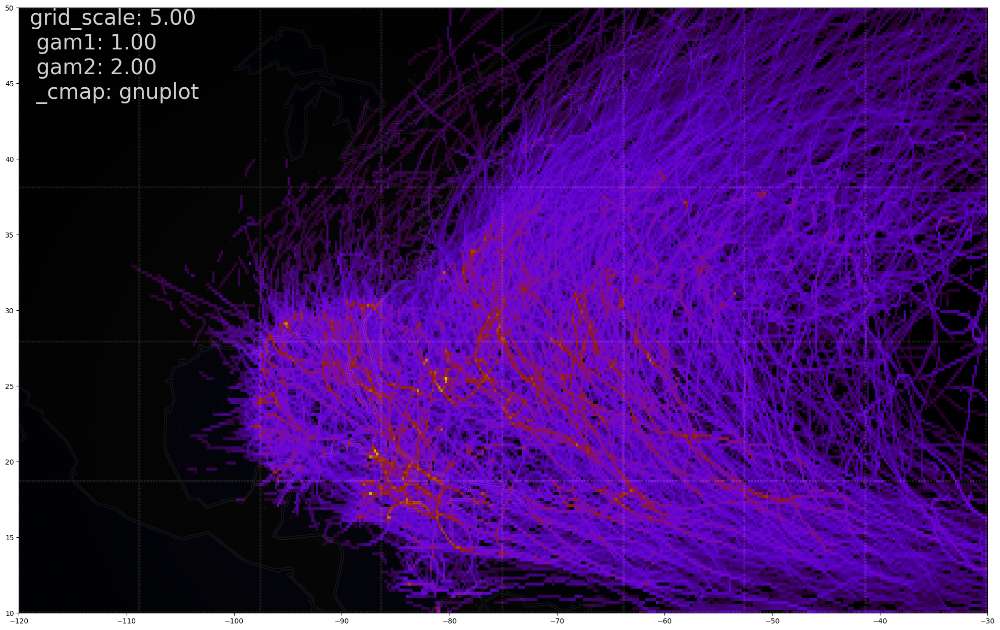

In [138]:
draw_map(5, x, y, 1.0, 2.0, color_map=9)

(328, 737)


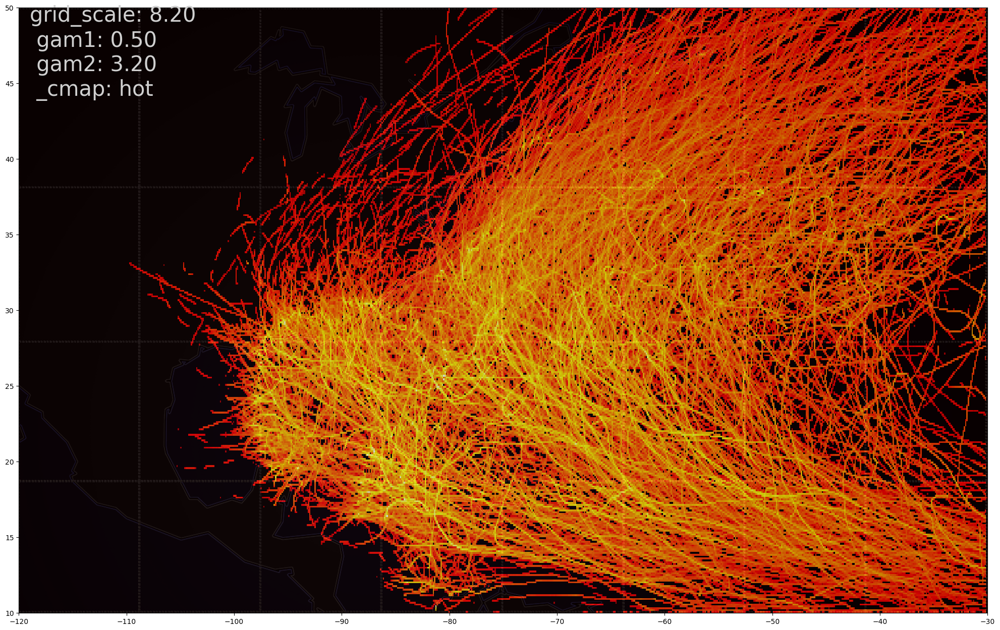

In [142]:
draw_map(8.2, x, y, 0.5, 3.2, color_map=4)

(612, 1377)


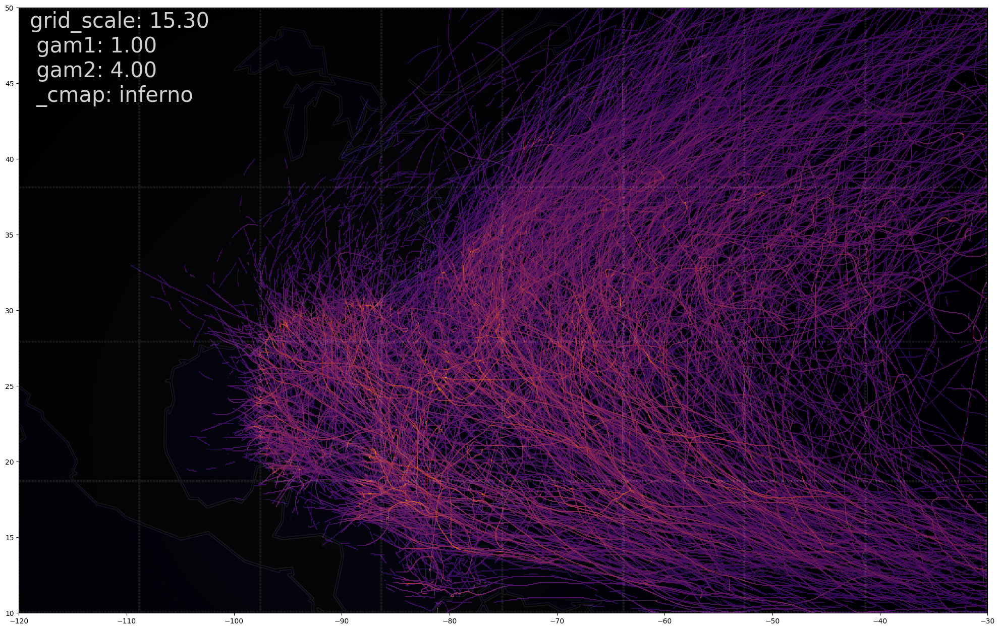

In [149]:
draw_map(15.3, x, y, 1.0, 4.0, color_map=0)

(612, 1377)


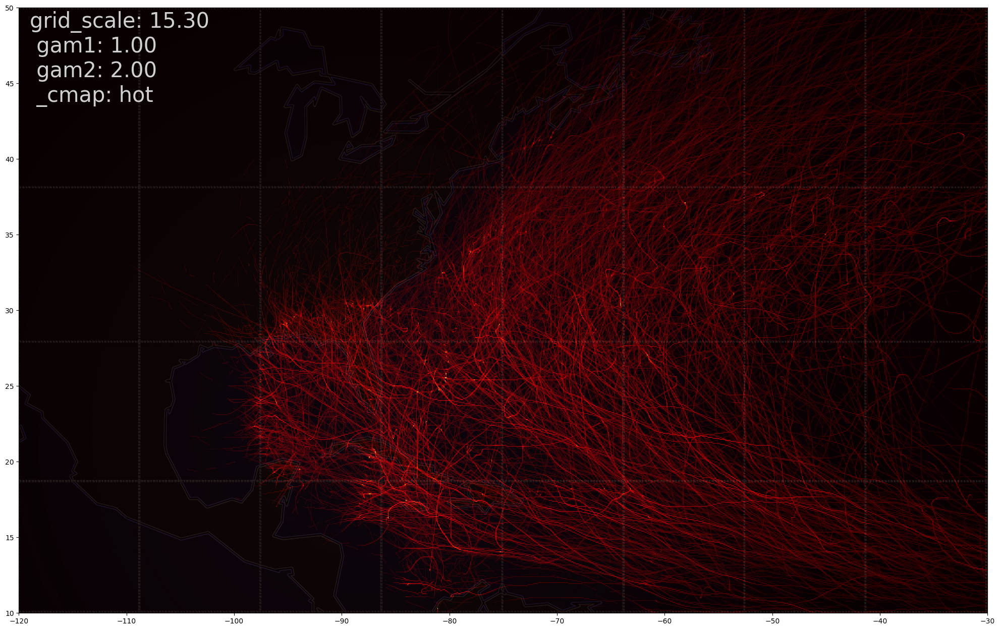

In [151]:
draw_map(15.3, x, y, 1.0, 2.0, color_map=4)

(120, 270)


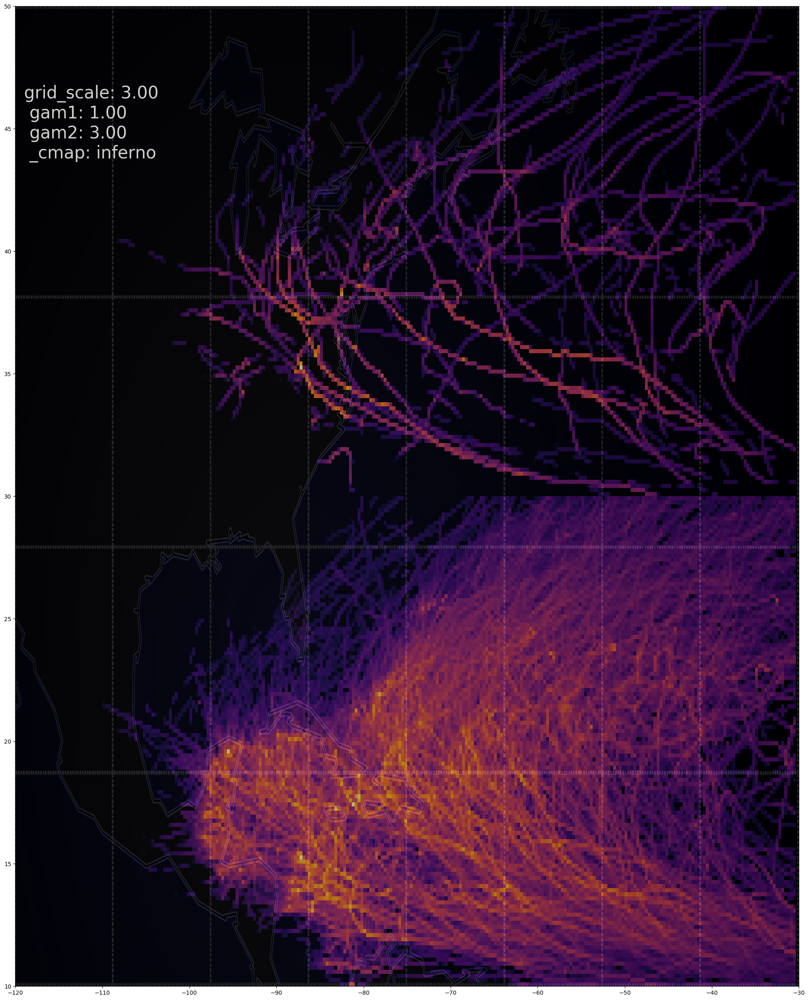

In [168]:
draw_map(3.0, x, y, small_x, small_y, 1.0, 3.0)

(120, 270)


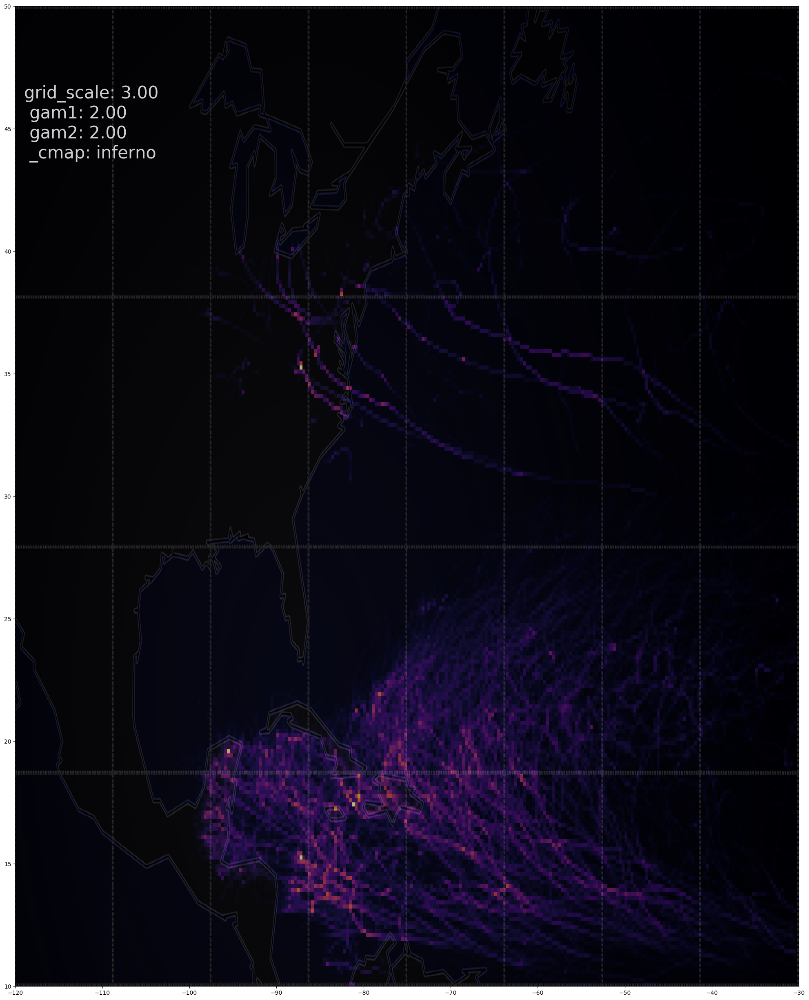

In [171]:
draw_map(3.0, x, y, small_x, small_y, 2.0, 2.0)

In [187]:
run_map_grid_search(x, y, small_x, small_y, 45, 250)

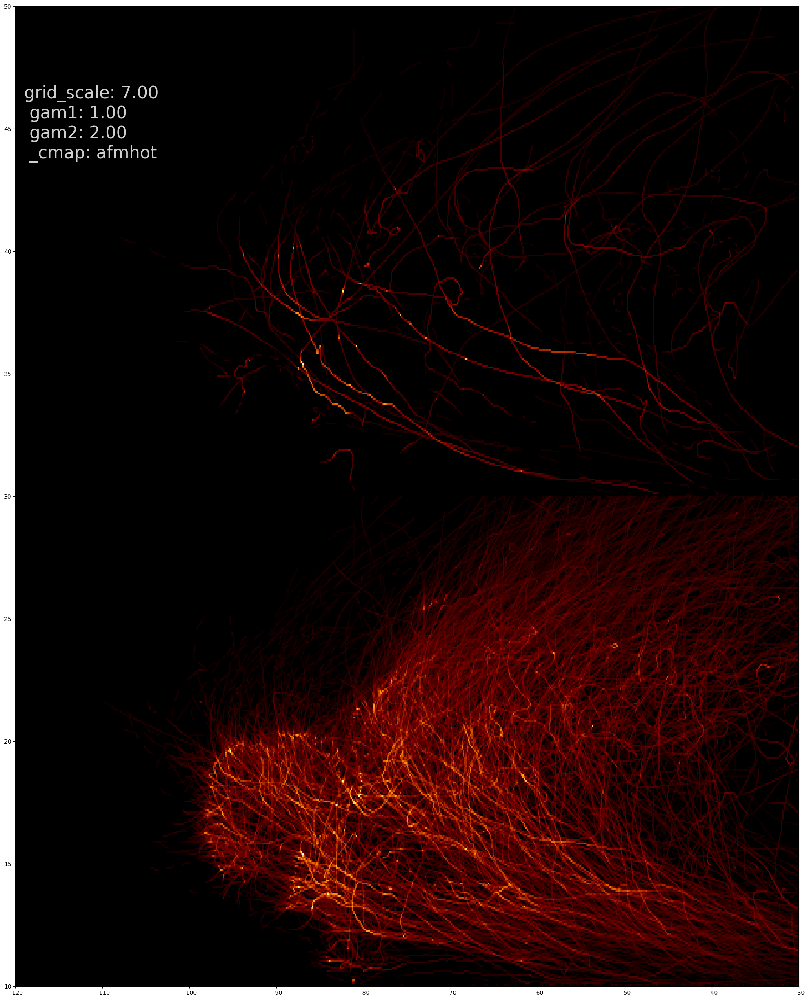

In [189]:
draw_map(7.0, x, y, small_x, small_y, 1.0, 2.0, color_map=5)

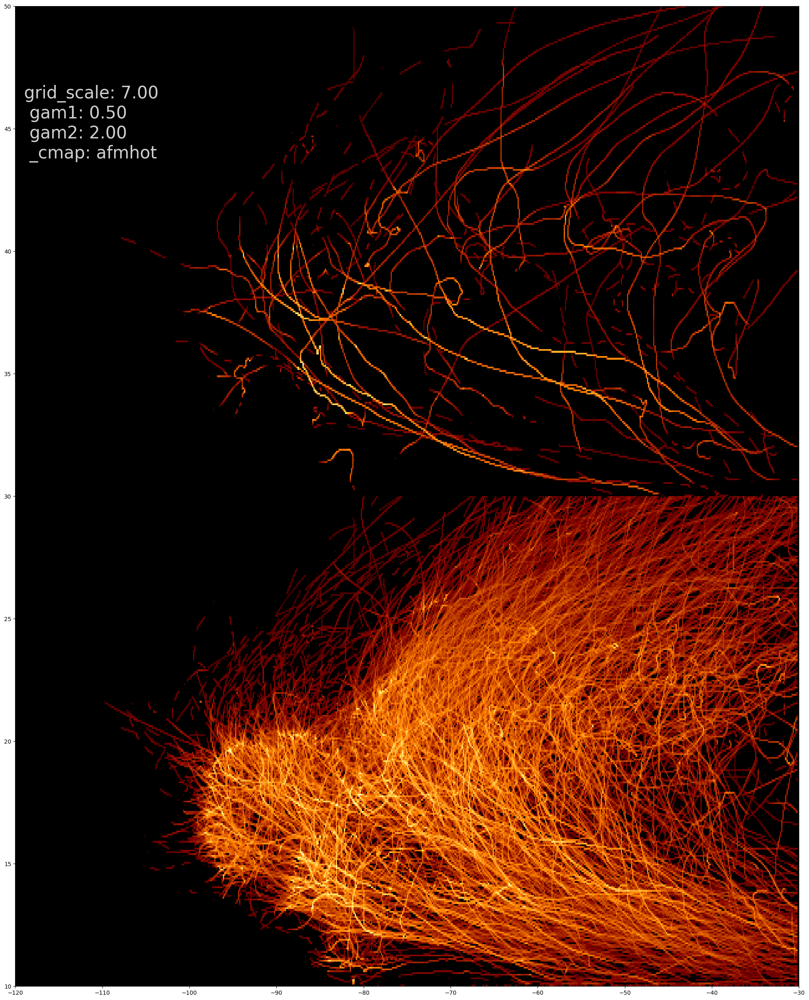

In [190]:
draw_map(7.0, x, y, small_x, small_y, 0.5, 2.0, color_map=5)

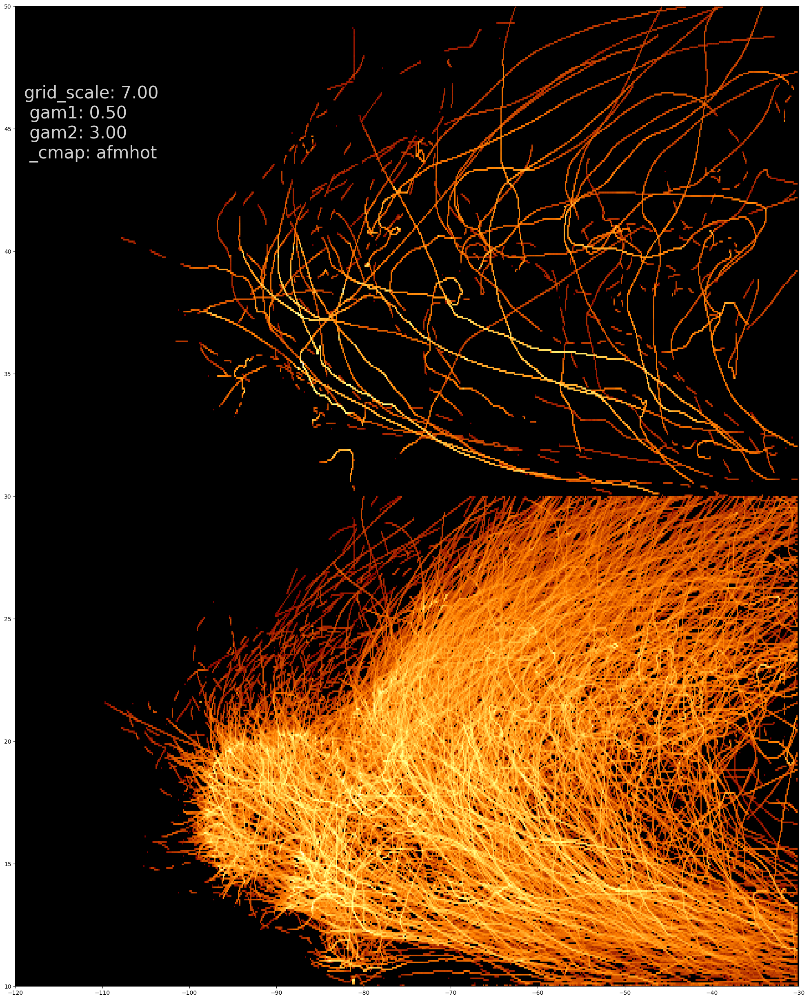

In [191]:
draw_map(7.0, x, y, small_x, small_y, 0.5, 3.0, color_map=5)

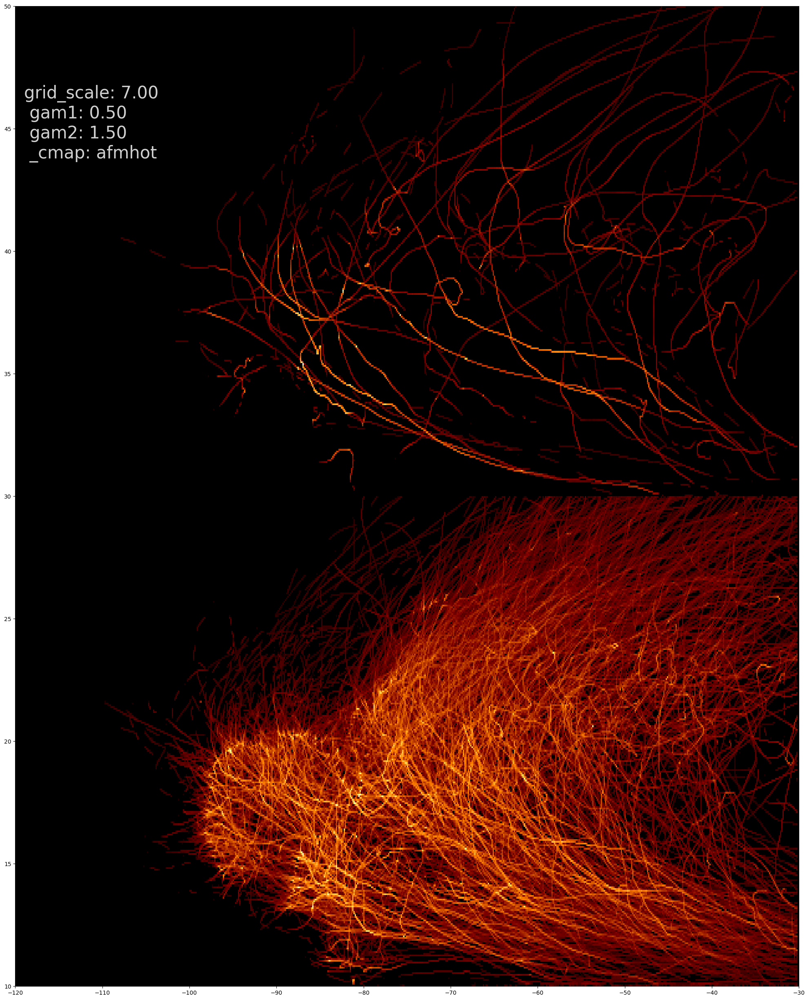

In [192]:
draw_map(7.0, x, y, small_x, small_y, 0.5, 1.5, color_map=5)

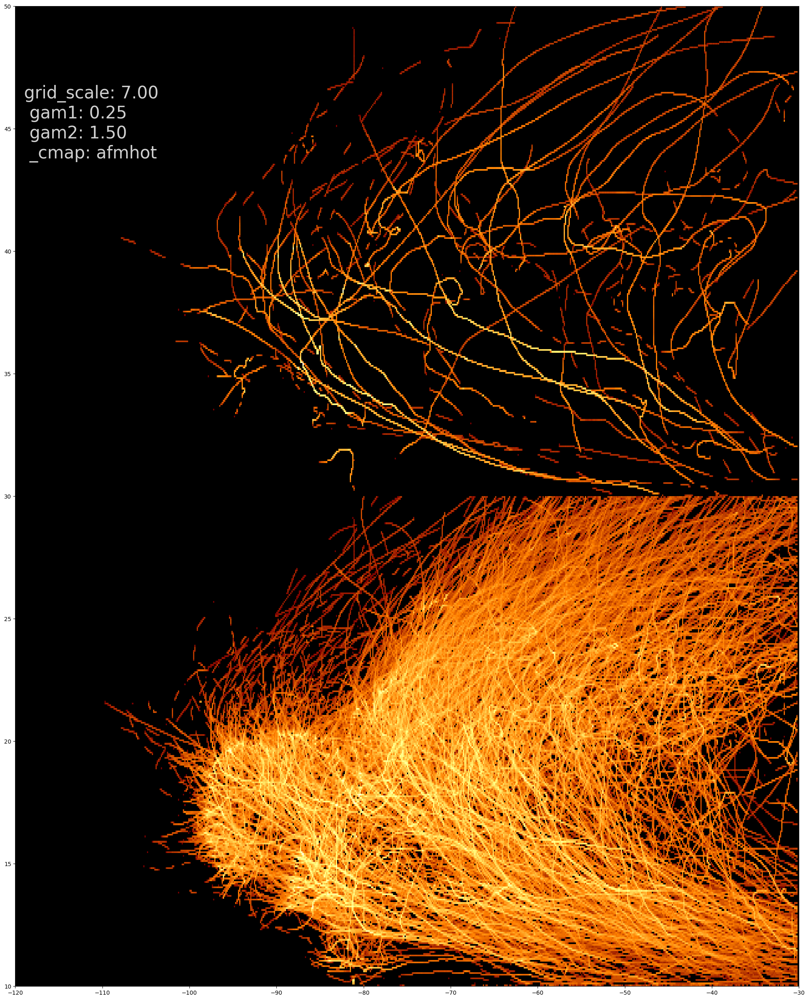

In [193]:
draw_map(7.0, x, y, small_x, small_y, 0.25, 1.5, color_map=5)

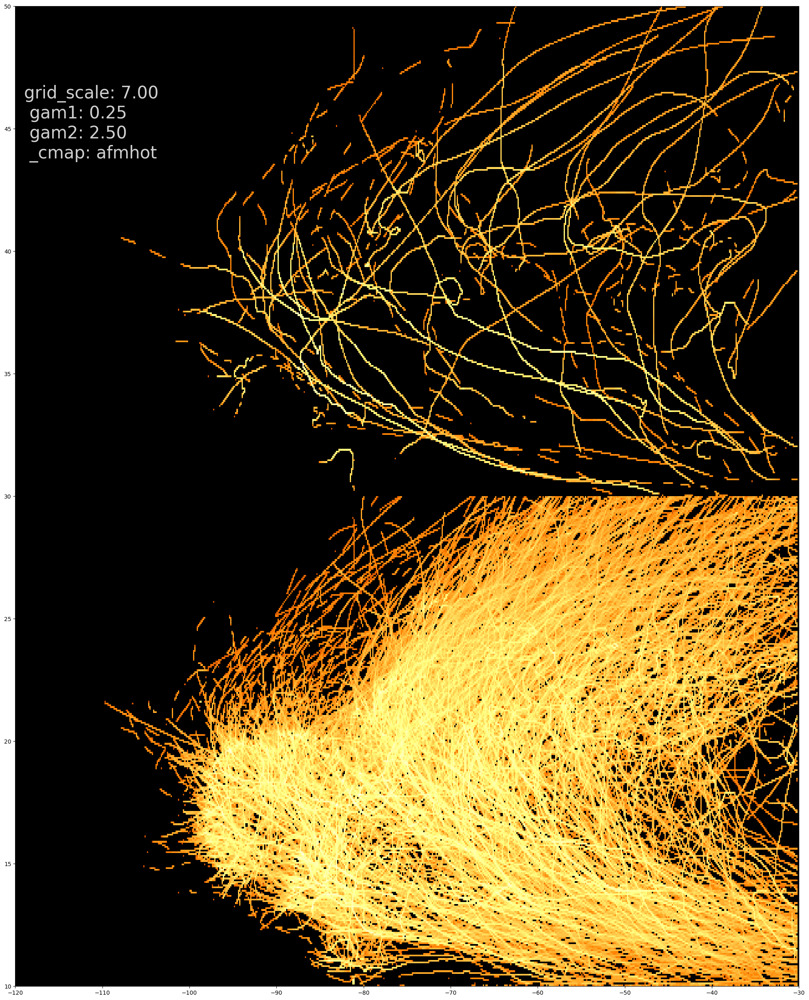

In [194]:
draw_map(7.0, x, y, small_x, small_y, 0.25, 2.5, color_map=5)

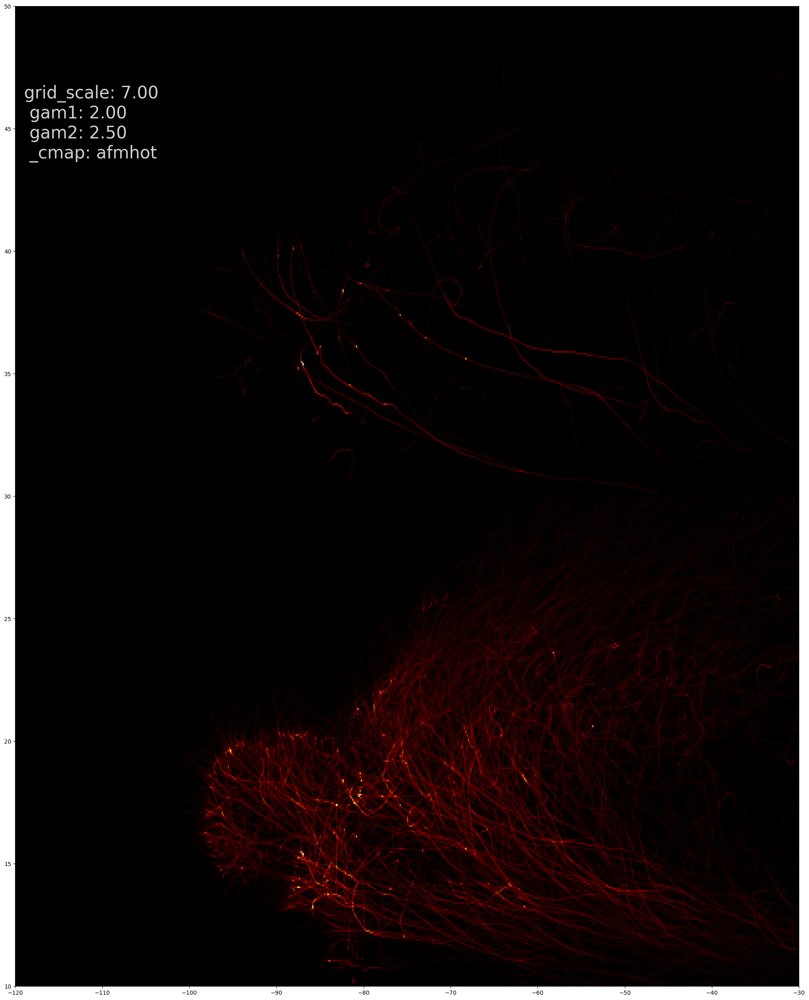

In [195]:
draw_map(7.0, x, y, small_x, small_y, 2.0, 2.5, color_map=5)

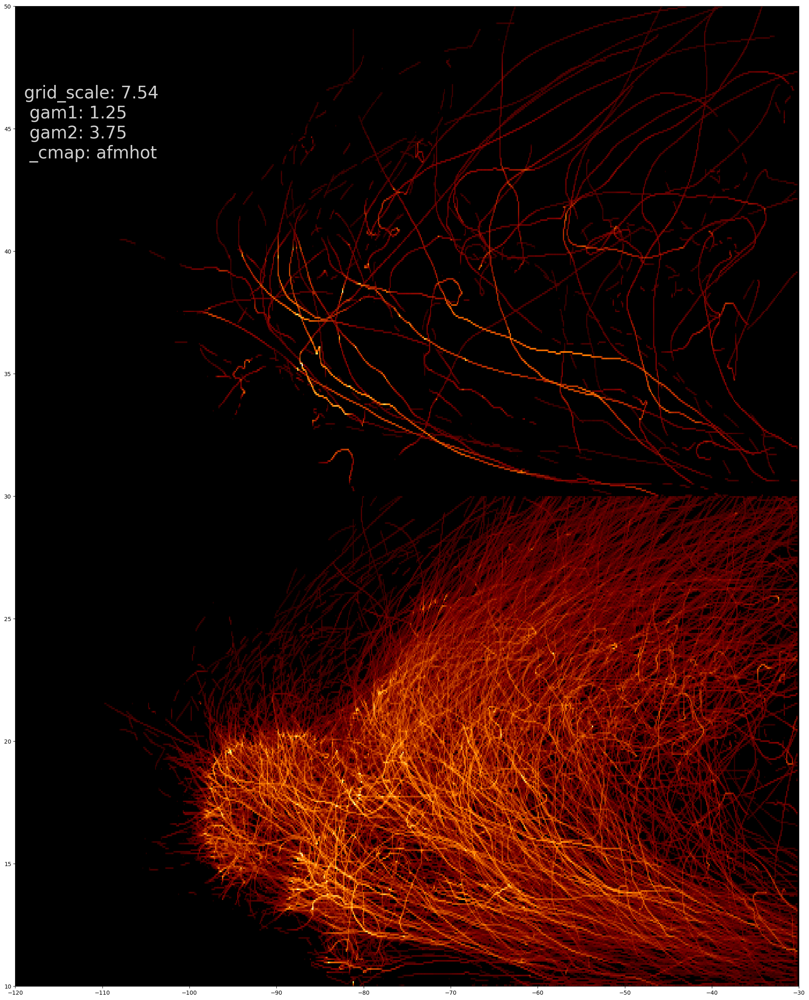

In [198]:
draw_map(7.54, x, y, small_x, small_y, 1.25, 3.75, color_map=5)

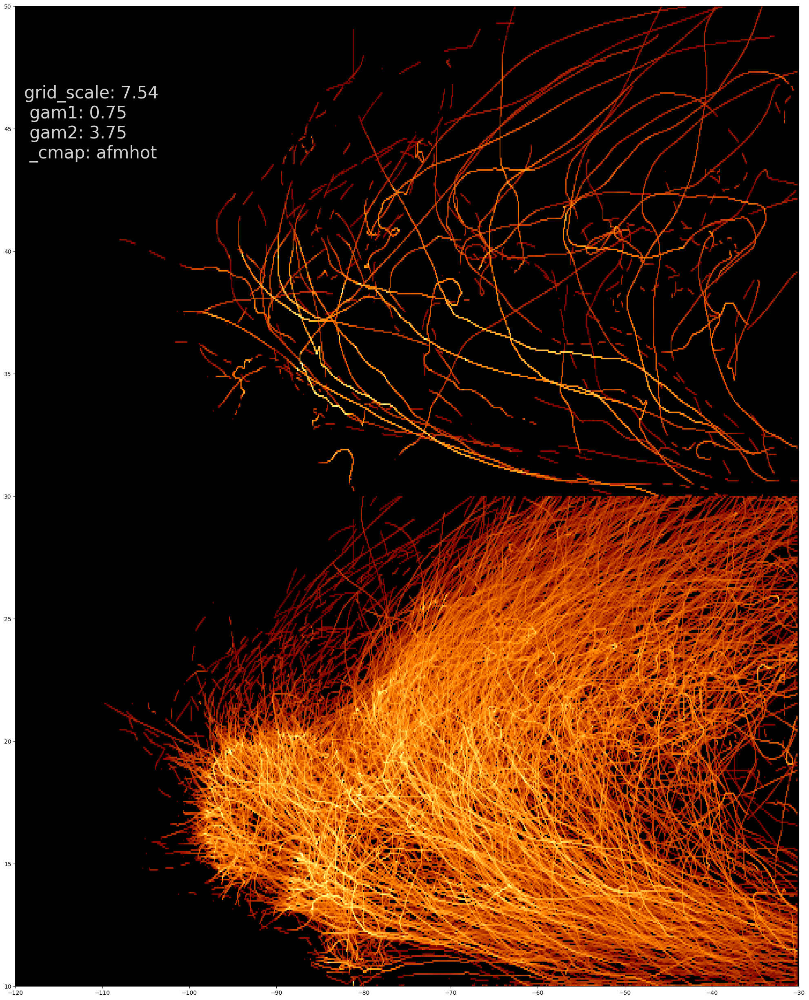

In [199]:
draw_map(7.54, x, y, small_x, small_y, 0.75, 3.75, color_map=5)

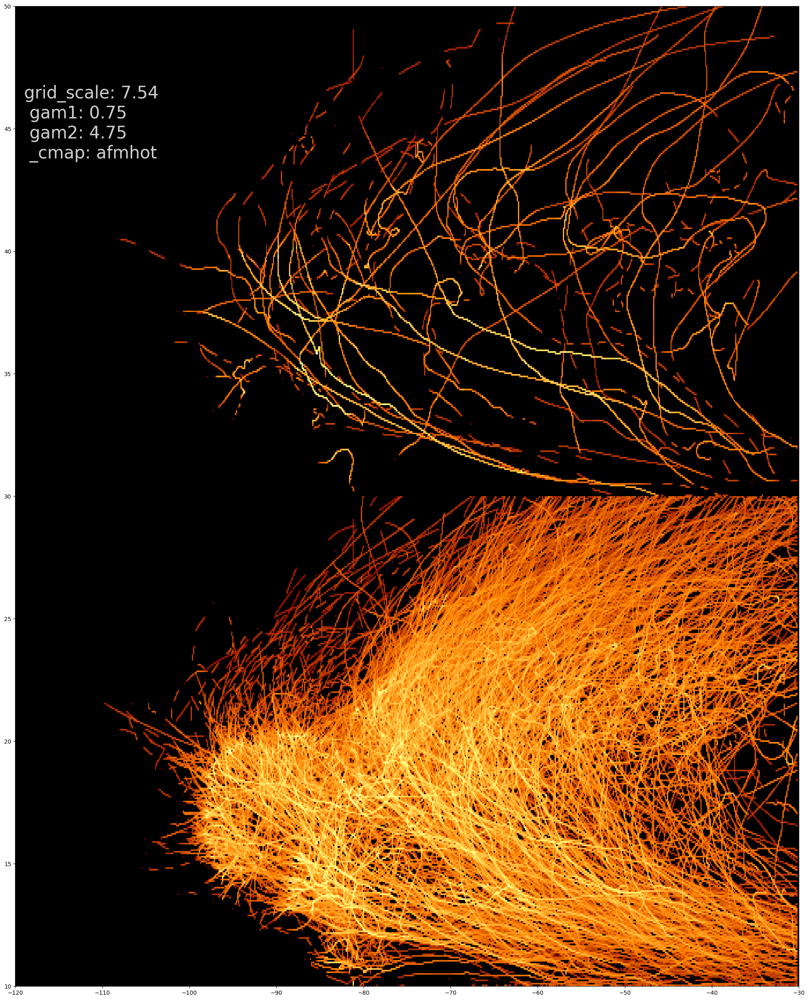

In [200]:
# weak areas too strong/burned in
draw_map(7.54, x, y, small_x, small_y, 0.75, 4.75, color_map=5)

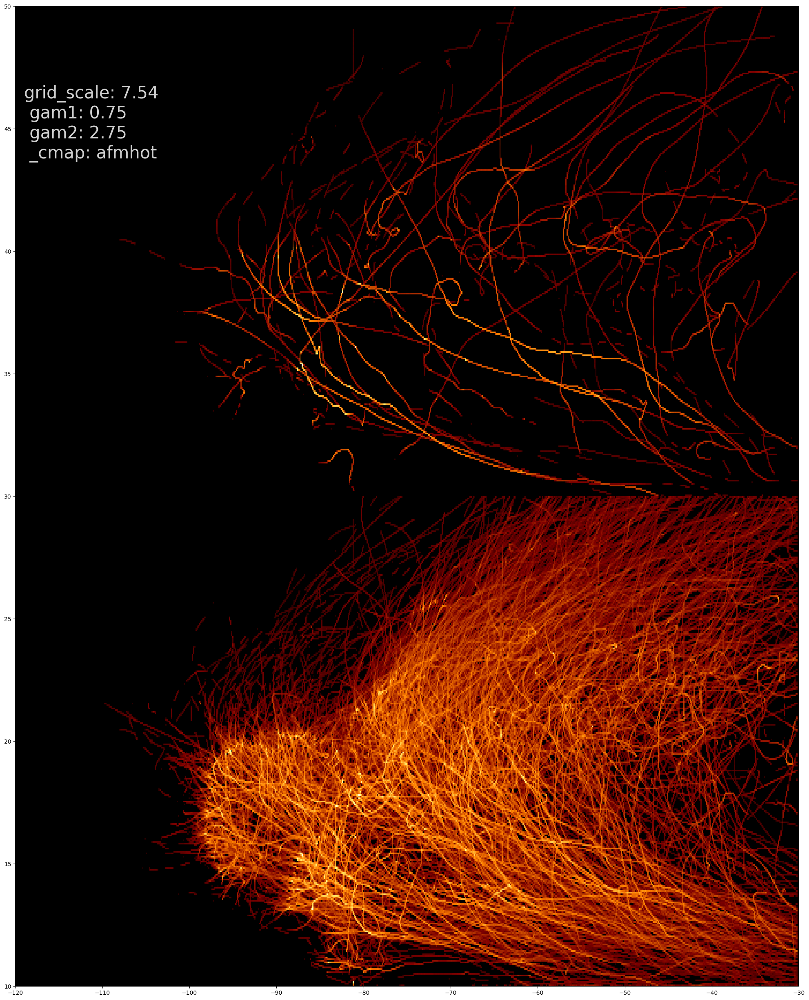

In [201]:
draw_map(7.54, x, y, small_x, small_y, 0.75, 2.75, color_map=5)

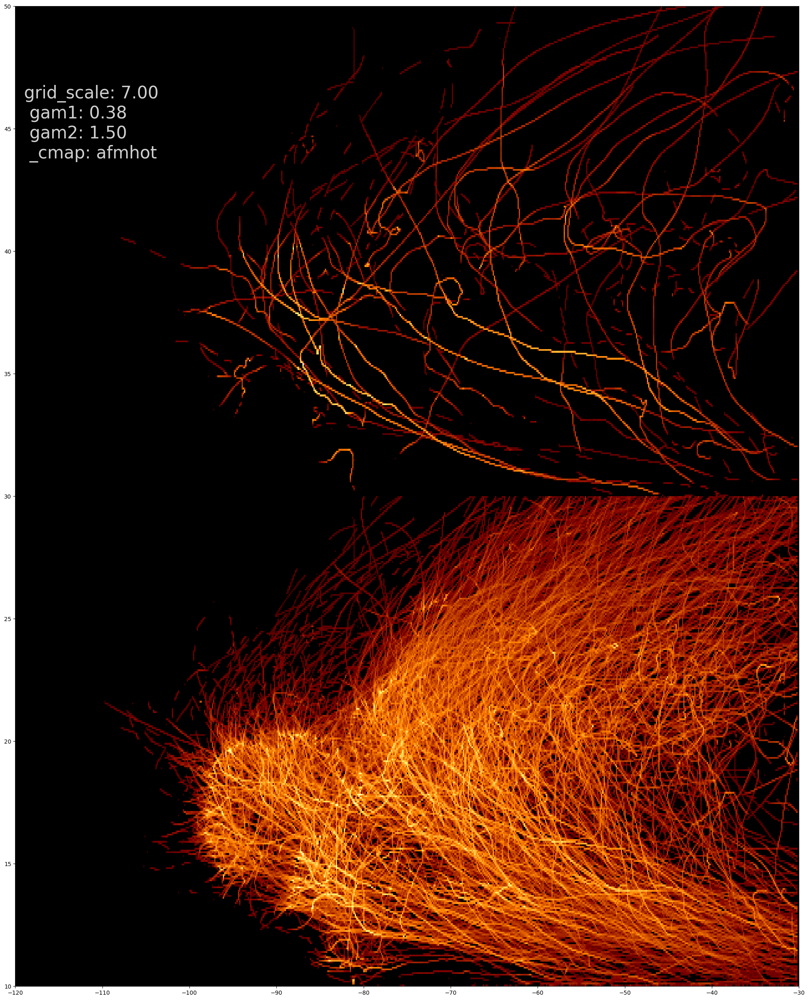

In [203]:
draw_map(7.0, x, y, small_x, small_y, 0.375, 1.5, color_map=5)

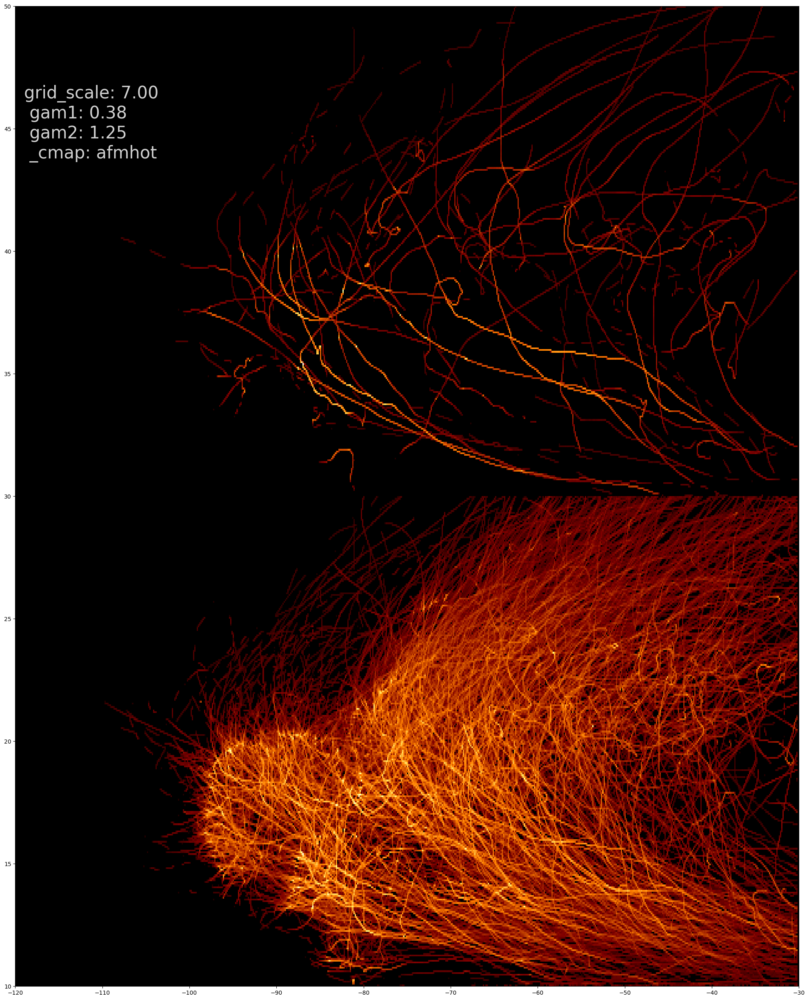

In [205]:
draw_map(7.0, x, y, small_x, small_y, 0.375, 1.25, color_map=5)